In [1]:
# -*- coding: utf-8 -*-
CUDA_VISIBLE_DEVICES=-1 
import os
import pandas as pd
from multiprocessing import Pool
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import scipy

import pybacktest as pb
import matplotlib.pyplot as plt

import threading
import multiprocessing
import tensorflow as tf
import tensorflow.contrib.slim as slim
import scipy.signal
%matplotlib inline
from random import choice
from time import sleep
from time import time
import sys
from trader_gym import environment
from A3C_class import AC_Network, Worker
import mpld3
mpld3.enable_notebook()
# %load_ext ipycache

ModuleNotFoundError: No module named 'pybacktest'

In [2]:
prefix = '../../hdf/'
postfix = ['RTS-12.15']
R = pd.read_pickle(str(postfix))
R = (R - R.mean()) / (R.max() - R.min())
old_R = R.copy()
vals = R.values
dep = 6
D = np.hstack([vals[i:-dep+i, :] for i in range(dep-1,0,-1)])
R = pd.DataFrame(D, R[dep:].index)

In [3]:
# Configs
NUM_ACTIONS = 3
max_episode_length = 300
gamma = .8
s_size = R.shape[1]
a_size = NUM_ACTIONS
load_model = False
model_path = 'model'
LENGTH = R.shape[0]
env = environment(R, LENGTH)

In [4]:
R

,0,1,2,3,4,5,6,7,8,9,...,175,176,177,178,179,180,181,182,183,184
ExchTime,,,,,,,,,,,,,,,,,,,,,
2015-09-15 10:06:00,-0.234266,-0.236396,-0.239365,-0.240525,-0.021028,-0.049987,-0.023171,-0.030077,-0.014499,-0.061378,...,-0.000002,-0.000213,-0.006310,-0.002283,-0.003737,-0.005172,0.011819,0.000466,-0.002896,-0.000791
2015-09-15 10:07:00,-0.239427,-0.237682,-0.239365,-0.236646,0.011759,-0.039362,-0.017670,-0.028284,-0.015213,-0.059772,...,-0.000002,-0.000213,-0.012828,-0.003457,-0.001986,-0.004713,0.002142,-0.000198,0.005329,0.000005
2015-09-15 10:08:00,-0.235556,-0.230608,-0.236110,-0.230828,0.018785,-0.032935,-0.017217,-0.008149,-0.000692,-0.053786,...,-0.000002,-0.000213,-0.005286,-0.002349,0.001378,-0.000755,0.001573,-0.000324,0.007291,-0.000057
2015-09-15 10:09:00,-0.229750,-0.217746,-0.230251,-0.216607,0.049230,0.042550,0.008888,0.074736,0.042643,-0.006195,...,0.000938,0.003129,-0.005286,-0.002675,-0.001408,-0.004370,0.006411,0.000391,0.000564,-0.000267
2015-09-15 10:10:00,-0.216202,-0.215817,-0.217881,-0.217900,-0.004635,-0.018769,-0.014622,0.000677,0.007591,-0.046779,...,-0.000942,-0.003451,-0.001934,-0.001963,-0.002083,-0.004979,0.005510,0.000687,-0.003239,-0.000729
2015-09-15 10:11:00,-0.217492,-0.211315,-0.217230,-0.210790,0.025810,0.019203,-0.006692,0.032397,0.027895,-0.014516,...,-0.000002,-0.000213,-0.003796,-0.002390,-0.001230,-0.004157,0.005557,0.000223,0.001894,-0.000499
2015-09-15 10:12:00,-0.211686,-0.207457,-0.210719,-0.206911,0.018785,0.030614,-0.005268,0.061221,0.058853,-0.009261,...,-0.000002,-0.000213,-0.008452,-0.003128,-0.002396,-0.004188,-0.004974,-0.000893,-0.005684,-0.000897
2015-09-15 10:13:00,-0.206524,-0.208100,-0.212021,-0.212082,-0.018686,-0.010768,-0.015412,-0.005115,0.007429,-0.028531,...,0.002817,0.002316,-0.004262,-0.002033,-0.003796,-0.003480,0.027283,0.001045,0.007478,-0.000612
2015-09-15 10:14:00,-0.211686,-0.213245,-0.214626,-0.212082,0.000049,-0.002046,-0.016273,-0.005804,0.006389,-0.027509,...,-0.000002,-0.000213,-0.009755,-0.003156,-0.007713,-0.004754,0.018460,0.002286,-0.005542,-0.000885


In [5]:
price = R.values[:,0]
price1 = np.zeros(LENGTH)
acts = np.zeros(LENGTH+1)
seelen = LENGTH
for i in range(seelen):
    a = env.sample()
    _, price1[i], done, n = env.step(a)
    acts[i] = a-1

    if(done):
        print(done, i)
        env.reset()


(True, 51890)


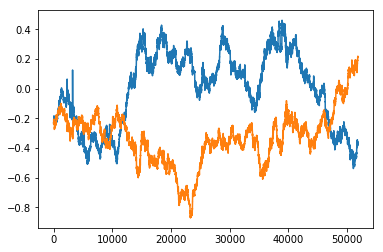

In [6]:
plt.plot(price[2:seelen])
npprice = acts[1:]*price1

# plt.plot(acts)
plt.plot(np.cumsum(price1)[0:seelen]+price[0])
plt.show()

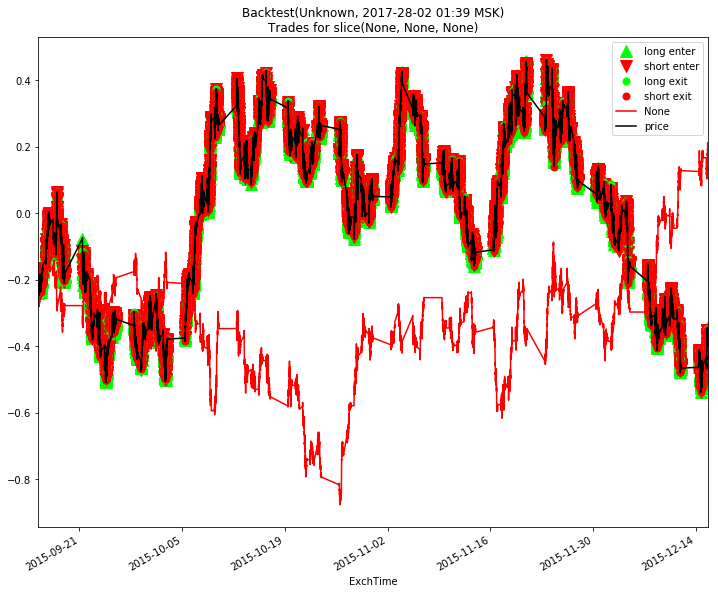

---------------------------------------------
|  Backtest(Unknown, 2017-28-02 01:39 MSK)  |
---------------------------------------------

backtest:
  days: 91
  from: '2015-09-15 10:07:00'
  to: '2015-12-15 15:55:00'
  trades: 22372
performance:
  PF: 1.0118
  RF: 0.5802
  averages:
    gain: 0.0034
    loss: -0.0034
    trade: 0.0
  payoff: 1.0143
  profit: 0.4467
  winrate: 0.4994
risk/return profile:
  MPI: 0.3864
  UPI: 0.0001
  WCDD (monte-carlo 0.99 quantile): 1.1369
  maxdd: 0.7699
  sharpe: 1.1124
  sortino: 2.0356

---------------------------------------------


In [12]:
# Торговая система - покупаем/продаем в зависимости от предсказанного класса
# acts = workers[0].acts
pacts = acts.copy()
for i in range(1,pacts.shape[0]):
    if pacts[i] == 0:
        if pacts[i-1] == -1:
            #from short
            pacts[i] = 0.5
        elif pacts[i-1] == 1:
            pacts[i] = -0.5
    
# plt.plot(pacts, '.')
data = old_R[dep-2:-1]

buy= cover = pd.Series(pacts == 1, index=data.index)
short = sell= pd.Series(pacts == -1, index=data.index)
cover = pd.Series(pacts > 0, index=data.index)
sell = pd.Series(pacts < 0, index=data.index)
# print(np.sum(buy-sell))
OHLC = data[[('DealPrice', 'close'), ('DealPrice', 'close'), ('DealPrice', 'close'), ('DealPrice', 'close')]]
OHLC.columns = ['O', 'H', 'L', 'C']
# Основной график эквити
bt = pb.Backtest(locals())
fig = plt.figure(figsize=(12, 10))
bt.plot_trades()
plt.legend(loc='best')
plt.plot()
plt.show()
# Отчет по системе
bt.summary()

In [9]:
pacts[:12]

array([ 1. ,  1. , -0.5,  0. , -1. , -1. , -1. , -1. , -1. , -1. ,  1. ,
       -0.5])